In [491]:
import pandas as pd  # Importing pandas library for data manipulation
import numpy as np   # Importing numpy library for numerical operations
import matplotlib.pyplot as plt  # Importing matplotlib library for data visualization
import seaborn as sns  # Importing seaborn library for statistical data visualization
from sklearn.preprocessing import LabelEncoder  # Importing LabelEncoder for encoding categorical variables
from sklearn.neighbors import LocalOutlierFactor  # Importing LocalOutlierFactor for outlier detection
from sklearn.preprocessing import StandardScaler  # Importing StandardScaler for feature scaling
import plotly.express as px  # Importing plotly express for interactive visualizations


In [492]:
def data_discovery(dataframe):
    """
    Explore the given dataframe.
    
    Parameters:
    dataframe (DataFrame): The dataframe to explore.
    
    Returns:
    None
    """
    # Print data information
    print("\n-------------------> Data Info <-------------------")
    print(dataframe.info())
    # Displays general information about the dataset, including column names, data types, and missing values.

    # Print data shape
    print("\n-------------------> Data Shape <-------------------")
    print(dataframe.shape)
    # Shows the dimensions (number of rows and columns) of the dataset.

    # Print column names
    print("\n-------------------> Columns <-------------------")
    print(dataframe.columns)
    # Lists the names of all columns in the dataset.

    # Print data types
    print("\n-------------------> Data Types <-------------------")
    print(dataframe.dtypes)
    # Shows the data types of each column in the dataset.

    # Print first 5 observations (Head)
    print("\n-------------------> Head <-------------------")
    print(dataframe.head())
    # Displays the first 5 rows of the dataset, allowing for a quick look at the data.

    # Print last 5 observations (Tail)
    print("\n-------------------> Tail <-------------------")
    print(dataframe.tail())
    # Displays the last 5 rows of the dataset, allowing for a quick look at the data.

    # Print total count of missing values
    print("\n-------------------> NULL Values <-------------------")
    missing_values = dataframe.isnull().sum()
    if missing_values.sum() == 0:
        print("No missing values found.")
    else:
        print(missing_values)
    # Shows the total count of missing values for each column in the dataset.

    # Print descriptive statistics
    print("\n-------------------> Descriptive Statistics <-------------------")
    print(dataframe.describe())
    # Provides descriptive statistics (count, mean, std, min, 25%, 50%, 75%, max) for numerical columns in the dataset

In [493]:
def explore_data_types(df):
    """
    Explore data types in the given dataframe.
    
    Parameters:
    df (DataFrame): The dataframe to explore data types in.
    
    Returns:
    None
    """
    # Display basic information about the dataset
    print("Basic information about the dataset:")
    print(df.info())

    # Detect numeric columns
    numeric_columns = df.select_dtypes(include=['int64', 'float64']).columns
    print("\nNumeric Columns:")
    print(numeric_columns)

    # Detect categorical columns
    categorical_columns = df.select_dtypes(include=['object']).columns
    print("\nCategorical Columns:")
    print(categorical_columns)

    # Detect cardinal columns (columns with unique values equal to the total number of rows)
    cardinal_columns = [column for column in df.columns if df[column].nunique() == len(df)]
    print("\nCardinal Columns:")
    print(cardinal_columns)


In [494]:
def visualize_numeric_columns_plotly(dataframe):
    """
    Visualize numeric columns of the given dataframe using Plotly.
    
    Parameters:
    dataframe (DataFrame): The dataframe to visualize numeric columns.
    
    Returns:
    None
    """
    # Numeric columns to visualize
    numeric_columns = ['Age', 'Flight Distance', 'Departure Delay', 'Arrival Delay',
                       'Departure and Arrival Time Convenience', 'Ease of Online Booking',
                       'Check-in Service', 'Online Boarding', 'Gate Location',
                       'On-board Service', 'Seat Comfort', 'Leg Room Service', 'Cleanliness',
                       'Food and Drink', 'In-flight Service', 'In-flight Wifi Service',
                       'In-flight Entertainment', 'Baggage Handling']

    # Define color scale for histograms
    color_scale = px.colors.qualitative.Set1

    # Iterate over each numeric column
    for i, column in enumerate(numeric_columns):
        # Determine color index by using modulo operator to loop over color scale
        color_index = i % len(color_scale)
        
        # Plot histogram for each numeric column with a different color
        fig = px.histogram(dataframe, x=column, nbins=30, title=f'{column} Distribution', 
                           labels={column: column, "count": "Frequency"}, color_discrete_sequence=[color_scale[color_index]])
        fig.update_layout(xaxis_title=column, yaxis_title='Frequency')
        fig.show()


In [495]:
def handle_missing_values(df):
    """
    Handles missing values in the DataFrame by visualizing and dropping them.
    
    Parameters:
        df (DataFrame): Input DataFrame
        
    Returns:
        DataFrame: DataFrame with missing values dropped
    """
    # Calculate the number of missing values for each column
    missing_values = df.isnull().sum()
    
    # Visualize the missing values
    plt.figure(figsize=(10, 6))
    missing_values.plot(kind='bar', color='skyblue')
    plt.xlabel('Columns')
    plt.ylabel('Number of Missing Values')
    plt.title('Number of Missing Values in Each Column')
    plt.show()

    # Drop missing values from the dataset
    df.dropna(inplace=True)

    # Check if there are any NaN values left in the dataset
    if df.isnull().sum().sum() == 0:
        print("No NaN values left in the dataset.")
    else:
        print("NaN values still present in the dataset:")
        print(df[df.isnull().any(axis=1)])

    return df


In [496]:
def label_encode_dataframe(df):
    """
    Encode categorical columns of a dataframe using LabelEncoder.
    
    Parameters:
    df (DataFrame): The dataframe to encode.
    
    Returns:
    DataFrame: The dataframe with encoded categorical columns.
    """
    # Initialize the LabelEncoder
    label_encoder = LabelEncoder()

    # Select categorical columns
    categorical_columns = df.select_dtypes(include=['object']).columns

    # Apply LabelEncoder to each categorical column
    for column in categorical_columns:
        df[column] = label_encoder.fit_transform(df[column])

    return df


In [497]:
def detect_and_plot_outliers(df):
    """
    Detect and plot outliers for each column in the dataframe.
    
    Parameters:
    df (DataFrame): The dataframe.
    
    Returns:
    None
    """
    # Local Outlier Factor for outlier detection
    lof = LocalOutlierFactor()
    outliers = lof.fit_predict(df)
    
    # Define the number of rows and columns for subplots
    num_cols = 3  # Number of columns per row
    num_rows = (len(df.columns) + num_cols - 1) // num_cols  # Calculate number of rows
    
    # Set up the figure and subplots
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    
    # Flatten the axs array if it's not already flat
    axs = axs.flatten() if isinstance(axs, np.ndarray) else [axs]
    
    # Iterate over each column
    for i, column in enumerate(df.columns):
        # Get the outlier indices for the current column
        outlier_indices = np.where(outliers == -1)[0]
        
        # Get the outlier values for the current column
        outlier_values = df[column].iloc[outlier_indices]
        
        # Plot histogram for outlier values
        ax = axs[i]
        ax.hist(df[column], bins=30, color='blue', alpha=0.5, label='All Data')
        ax.hist(outlier_values, bins=30, color='red', alpha=0.8, label='Outliers')
        ax.set_title(f'Outlier Detection for {column}')
        ax.set_xlabel('Value')
        ax.set_ylabel('Frequency')
        ax.legend()

    # Hide empty subplots
    for j in range(i + 1, len(axs)):
        axs[j].axis('off')

    # Adjust layout and show plot
    plt.tight_layout()
    plt.show()


In [498]:
def remove_outliers(df, outliers):
    """
    Remove outliers from the DataFrame.
    
    Parameters:
    df (DataFrame): The original dataframe.
    outliers (array): Array containing outlier labels (-1 for outlier, 1 for inlier).
    
    Returns:
    DataFrame: The dataframe with outliers removed.
    """
    # Filter outlier indices
    outlier_indices = np.where(outliers == -1)[0]
    
    # Remove outliers from the DataFrame
    df_cleaned = df.drop(df.index[outlier_indices])
    
    return df_cleaned


In [499]:
def visualize_scatterplots(df_original, df_cleaned):
    """
    Visualize scatter plots of each column in the original and cleaned dataframes for comparison.
    
    Parameters:
    df_original (DataFrame): The original dataframe.
    df_cleaned (DataFrame): The cleaned dataframe with outliers removed.
    
    Returns:
    None
    """
    # Set up subplots
    fig, axes = plt.subplots(nrows=len(df_original.columns), ncols=2, figsize=(15, 5 * len(df_original.columns)))
    
    # Iterate through each column
    for i, column in enumerate(df_original.columns):
        # Original data scatter plot
        axes[i, 0].scatter(range(len(df_original)), df_original[column], color='purple', alpha=0.5)
        axes[i, 0].set_title(f'Original: {column}')
        axes[i, 0].set_xlabel('Index')
        axes[i, 0].set_ylabel(column)
        
        # Cleaned data scatter plot
        axes[i, 1].scatter(range(len(df_cleaned)), df_cleaned[column], color='orange', alpha=0.5)
        axes[i, 1].set_title(f'Cleaned: {column}')
        axes[i, 1].set_xlabel('Index')
        axes[i, 1].set_ylabel(column)
        
    plt.tight_layout()
    plt.show()


In [500]:
def standardize_dataframe(df):
    """
    Standardizes all numerical columns in the DataFrame.
    
    Parameters:
        df (DataFrame): Input DataFrame
        
    Returns:
        DataFrame: Standardized DataFrame
    """
    # Create a StandardScaler object
    scaler = StandardScaler()

    # Make a copy of the entire dataset to apply standardization
    df_standardized = df.copy()

    # Standardize all columns in the dataset
    df_standardized[df.columns] = scaler.fit_transform(df[df.columns])

    return df_standardized


In [501]:
def correlation_analysis(df):
    """
    Perform correlation analysis on the dataframe.
    
    Parameters:
    df (DataFrame): The dataframe.
    
    Returns:
    None
    """
    # Calculate correlation matrix
    corr_matrix = df.corr()
    
    # Create a mask to display only the lower triangle of the heatmap
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    
    # Plot correlation matrix as a heatmap
    plt.figure(figsize=(12, 8))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", mask=mask, vmin=-1, vmax=1)
    plt.title('Correlation Matrix')
    plt.show()


In [502]:
def feature_selection(df, threshold=0.7):
    """
    Perform feature selection based on correlation matrix.
    
    Parameters:
    df (DataFrame): The dataframe.
    threshold (float): The threshold for correlation coefficient. Default is 0.7.
    
    Returns:
    DataFrame: The dataframe with selected features.
    """
    # Calculate correlation matrix
    corr_matrix = df.corr().abs()
    
    # Upper triangular matrix
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    
    # Find features with correlation above threshold
    to_drop = [column for column in upper.columns if any(upper[column] > threshold)]
    
    # Drop highly correlated features
    df_selected = df.drop(to_drop, axis=1)
    
    return df_selected


In [503]:
def plot_feature_importance(df, target_variable):
    """
    Plot feature importance based on correlation with the target variable.
    
    Parameters:
    df (DataFrame): The dataframe.
    target_variable (str): The name of the target variable.
    
    Returns:
    None
    """
    # Calculate correlation with the target variable
    corr_with_target = df.corr().abs()[target_variable].sort_values(ascending=False)
    
    # Remove the target variable itself
    corr_with_target = corr_with_target.drop(target_variable)
    
    # Plot feature importance
    plt.figure(figsize=(10, 6))
    corr_with_target.plot(kind='bar', color='skyblue')
    plt.xlabel('Features')
    plt.ylabel('Absolute Correlation with Target')
    plt.title('Feature Importance based on Correlation with Target Variable')
    plt.xticks(rotation=45, ha='right')
    plt.show()


In [504]:
def remove_low_importance_features(df, low_importance_features):
    """
    Remove features with low importance.
    
    Parameters:
    df (DataFrame): The dataframe.
    low_importance_features (list): List of low importance features to remove.
    
    Returns:
    DataFrame: The dataframe with low importance features removed.
    """
    # Drop low importance features from the dataframe
    df_cleaned = df.drop(low_importance_features, axis=1)
    
    return df_cleaned


In [505]:
def visualize_cleaned_data(df):
    """
    Visualize numerical columns using histograms.
    
    Parameters:
    df (DataFrame): The dataframe.
    
    Returns:
    None
    """
    num_columns = df.select_dtypes(include=['int64', 'float64']).columns
    
    # Calculate the number of rows and columns for subplots
    num_plots = len(num_columns)
    num_rows = (num_plots + 1) // 2
    num_cols = 2
    
    # Create subplots
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))
    
    # Flatten axes if num_rows > 1
    if num_rows > 1:
        axes = axes.flatten()
    
    # Loop through each numerical column
    for i, column in enumerate(num_columns):
        # Plot histogram
        axes[i].hist(df[column], bins=20, color='skyblue')
        axes[i].set_title(f'Distribution of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')
    
    # Hide empty subplots
    for j in range(i+1, num_rows*num_cols):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()


In [506]:
# Load the dataset from the specified file path.
df = pd.read_csv("/Users/sinemsen/Downloads/airline_passenger_satisfaction.csv")

In [507]:
# Call the explore_data function
data_discovery(df)


-------------------> Data Info <-------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   ID                                      129880 non-null  int64  
 1   Gender                                  129880 non-null  object 
 2   Age                                     129880 non-null  int64  
 3   Customer Type                           129880 non-null  object 
 4   Type of Travel                          129880 non-null  object 
 5   Class                                   129880 non-null  object 
 6   Flight Distance                         129880 non-null  int64  
 7   Departure Delay                         129880 non-null  int64  
 8   Arrival Delay                           129487 non-null  float64
 9   Departure and Arrival Time Convenience  129880 non-null  int6

In [508]:
# Perform data type exploration using the function
explore_data_types(df)

Basic information about the dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 24 columns):
 #   Column                                  Non-Null Count   Dtype  
---  ------                                  --------------   -----  
 0   ID                                      129880 non-null  int64  
 1   Gender                                  129880 non-null  object 
 2   Age                                     129880 non-null  int64  
 3   Customer Type                           129880 non-null  object 
 4   Type of Travel                          129880 non-null  object 
 5   Class                                   129880 non-null  object 
 6   Flight Distance                         129880 non-null  int64  
 7   Departure Delay                         129880 non-null  int64  
 8   Arrival Delay                           129487 non-null  float64
 9   Departure and Arrival Time Convenience  129880 non-null  int64  
 10  Ease of

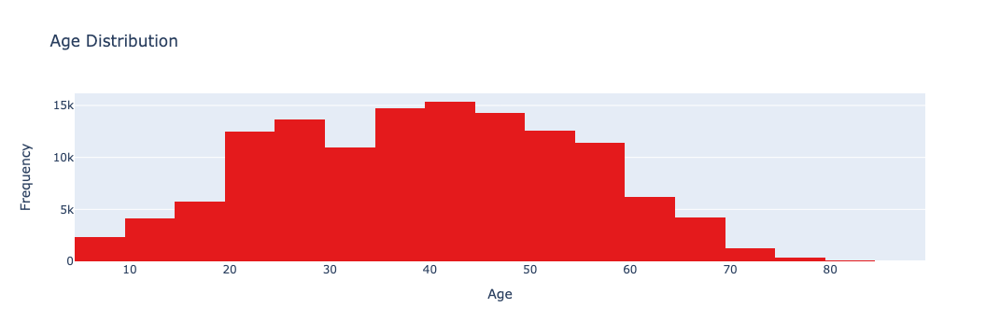

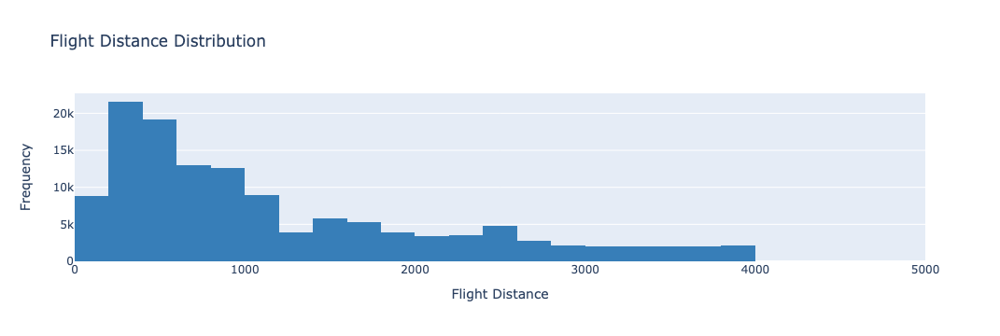

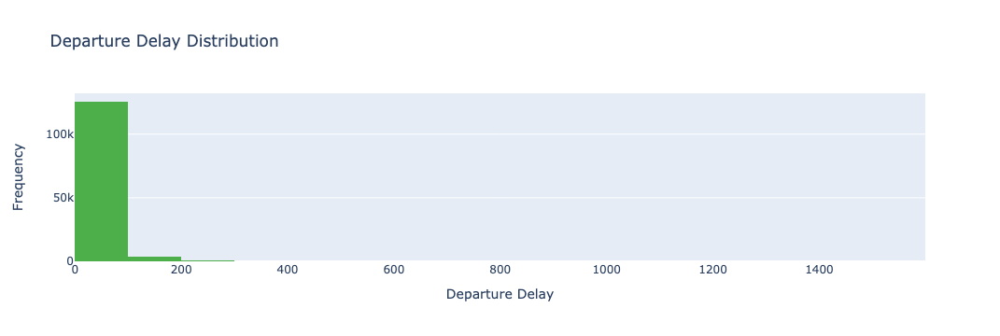

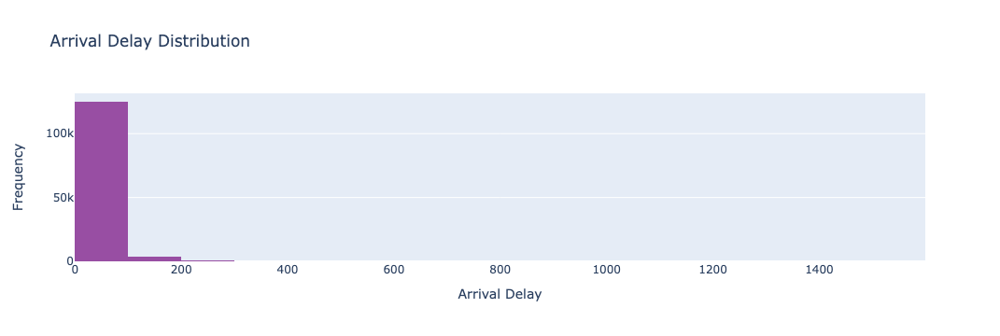

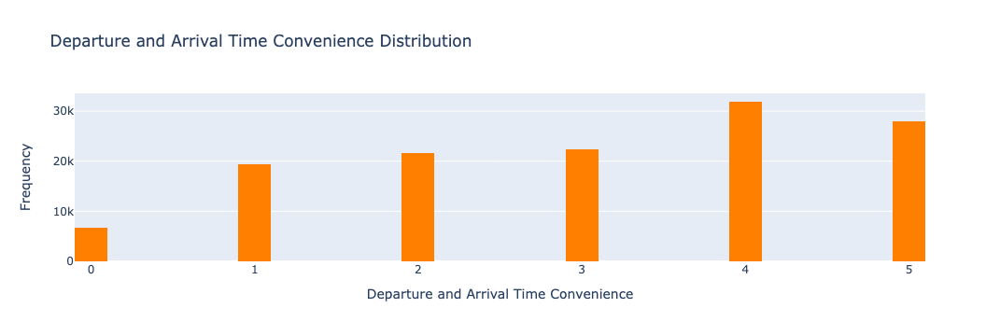

...

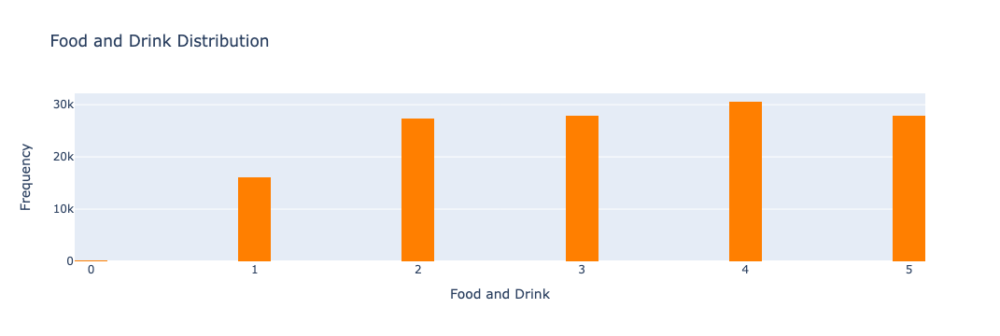

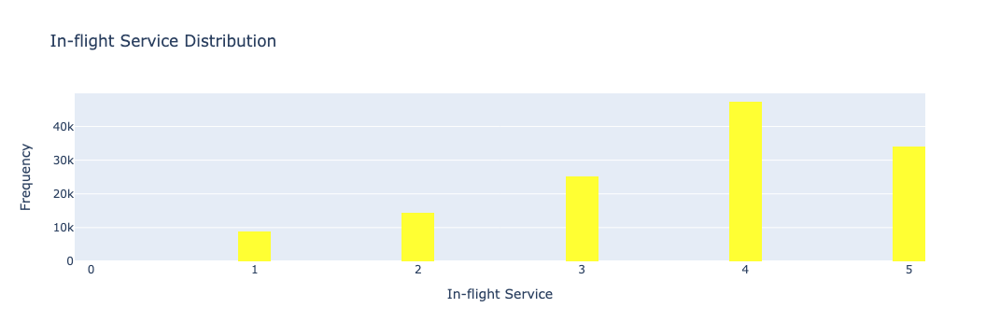

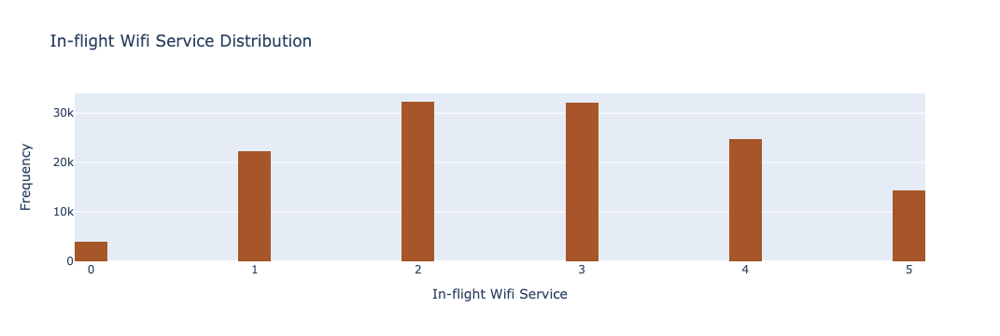

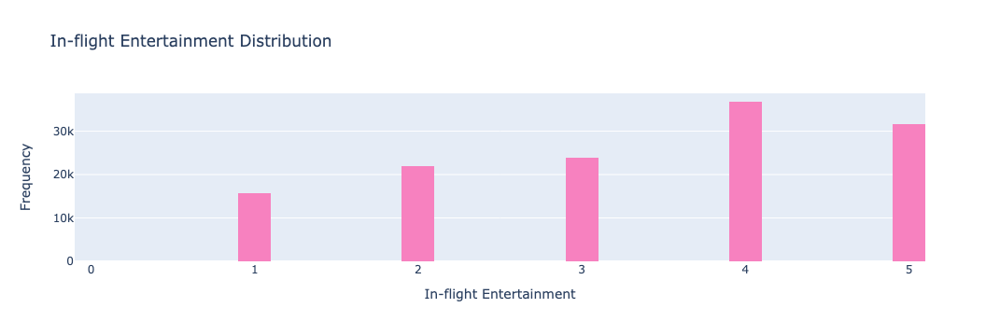

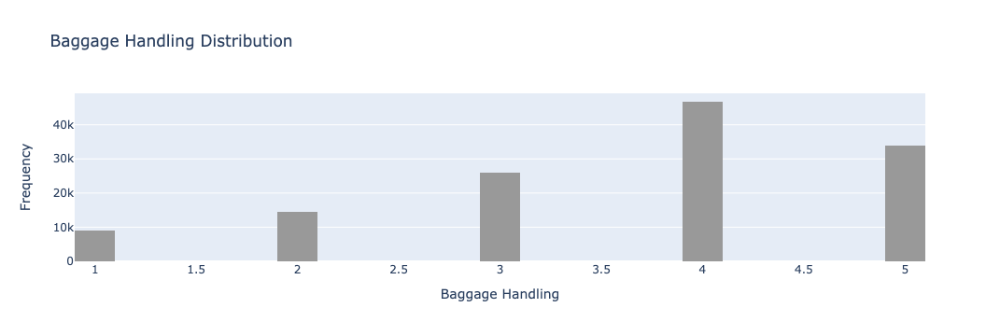

In [509]:
# Call the function to visualize numeric columns with Plotly
visualize_numeric_columns_plotly(df)

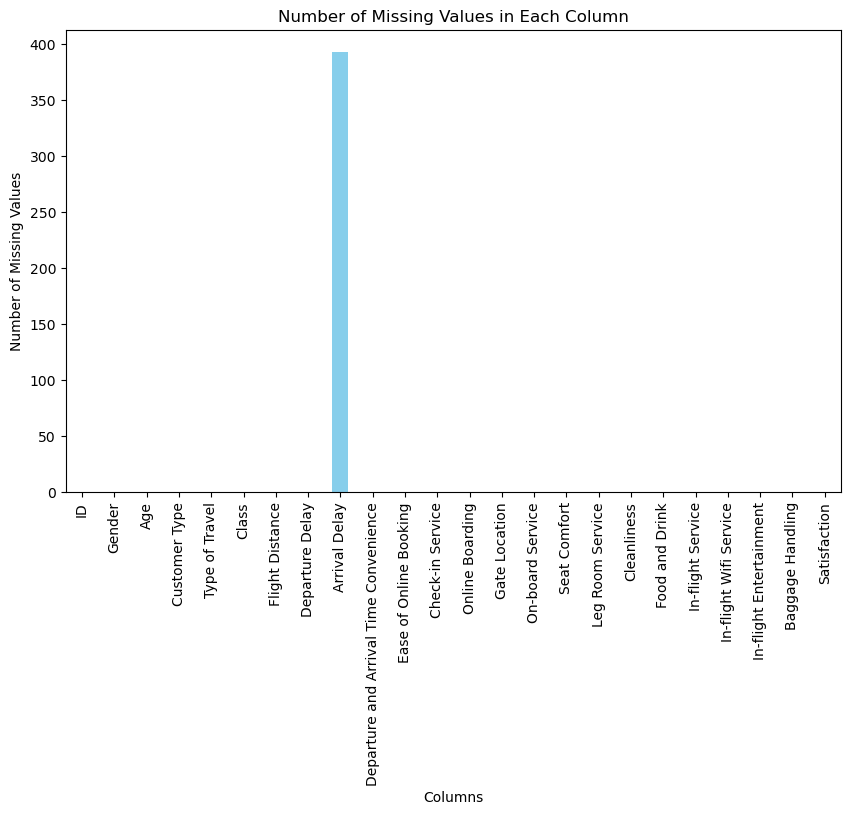

No NaN values left in the dataset.


In [510]:
# Handle missing values in the dataframe and visualize them
df_processed = handle_missing_values(df)

In [511]:
# Apply the label encoding function
df = label_encode_dataframe(df)

# Display the first few rows of the transformed dataframe
print(df.head())

   ID  Gender  Age  Customer Type  Type of Travel  Class  Flight Distance  \
0   1       1   48              0               0      0              821   
1   2       0   35              1               0      0              821   
2   3       1   41              1               0      0              853   
3   4       1   50              1               0      0             1905   
4   5       0   49              1               0      0             3470   

   Departure Delay  Arrival Delay  Departure and Arrival Time Convenience  \
0                2            5.0                                       3   
1               26           39.0                                       2   
2                0            0.0                                       4   
3                0            0.0                                       2   
4                0            1.0                                       3   

   ...  On-board Service  Seat Comfort  Leg Room Service  Cleanliness  \
0

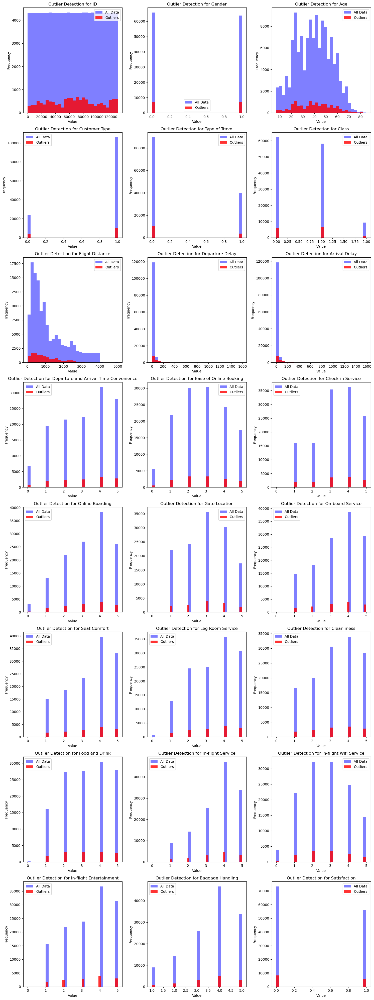

In [512]:
# Call the function to detect and plot outliers for each column
detect_and_plot_outliers(df)

In [513]:
# Remove outliers from the dataframe
df_cleaned = remove_outliers(df, outliers)

# Print the shape of the cleaned dataframe
print("Shape of the cleaned dataframe:", df_cleaned.shape)

Shape of the cleaned dataframe: (115831, 24)


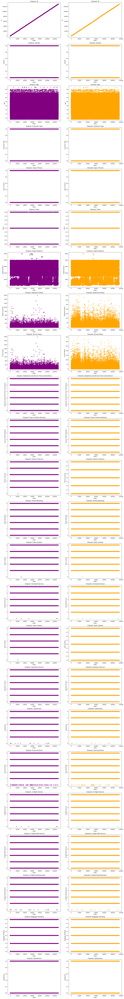

In [514]:
# Call the function to visualize scatter plots
visualize_scatterplots(df, df_cleaned)

In [515]:
# Test the function
df_standardized = standardize_dataframe(df)

# Check the standardized data
print("Standardized Data:")
print(df_standardized.head())

Standardized Data:
         ID    Gender       Age  Customer Type  Type of Travel     Class  \
0 -1.732674  1.014931  0.566973      -2.111957       -0.669083 -0.955479   
1 -1.732648 -0.985288 -0.292955       0.473495       -0.669083 -0.955479   
2 -1.732621  1.014931  0.103935       0.473495       -0.669083 -0.955479   
3 -1.732594  1.014931  0.699270       0.473495       -0.669083 -0.955479   
4 -1.732568 -0.985288  0.633122       0.473495       -0.669083 -0.955479   

   Flight Distance  Departure Delay  Arrival Delay  \
0        -0.370115        -0.333311      -0.262342   
1        -0.370115         0.299388       0.621567   
2        -0.338036        -0.386036      -0.392329   
3         0.716540        -0.386036      -0.392329   
4         2.285372        -0.386036      -0.366332   

   Departure and Arrival Time Convenience  ...  On-board Service  \
0                               -0.037562  ...         -0.297744   
1                               -0.692535  ...          1.25622

/opt/anaconda3/lib/python3.11/site-packages/seaborn/matrix.py:260: FutureWarning:

Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior



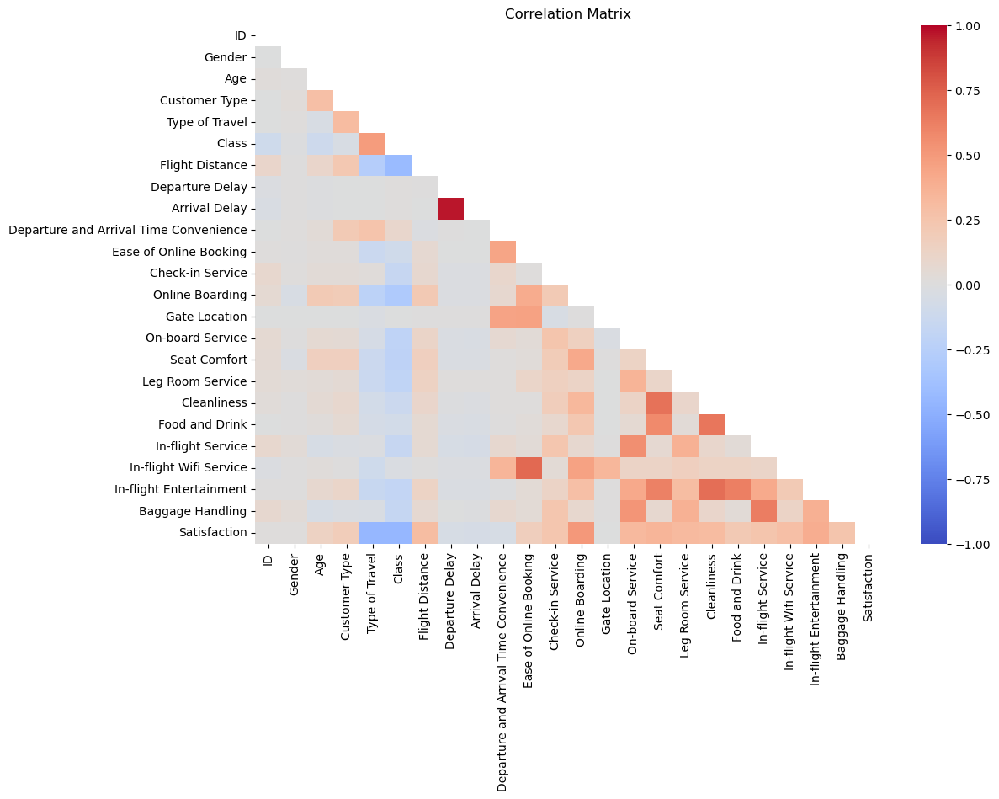

In [516]:
# Call the function for correlation analysis
correlation_analysis(df)

In [517]:
# Perform feature selection
df_selected = feature_selection(df_cleaned)

# Print selected features
print("Selected Features:")
print(df_selected.columns)


Selected Features:
Index(['ID', 'Gender', 'Age', 'Customer Type', 'Type of Travel', 'Class',
       'Flight Distance', 'Departure Delay',
       'Departure and Arrival Time Convenience', 'Ease of Online Booking',
       'Check-in Service', 'Online Boarding', 'Gate Location',
       'On-board Service', 'Seat Comfort', 'Leg Room Service', 'Cleanliness',
       'Food and Drink', 'In-flight Service', 'Baggage Handling',
       'Satisfaction'],
      dtype='object')


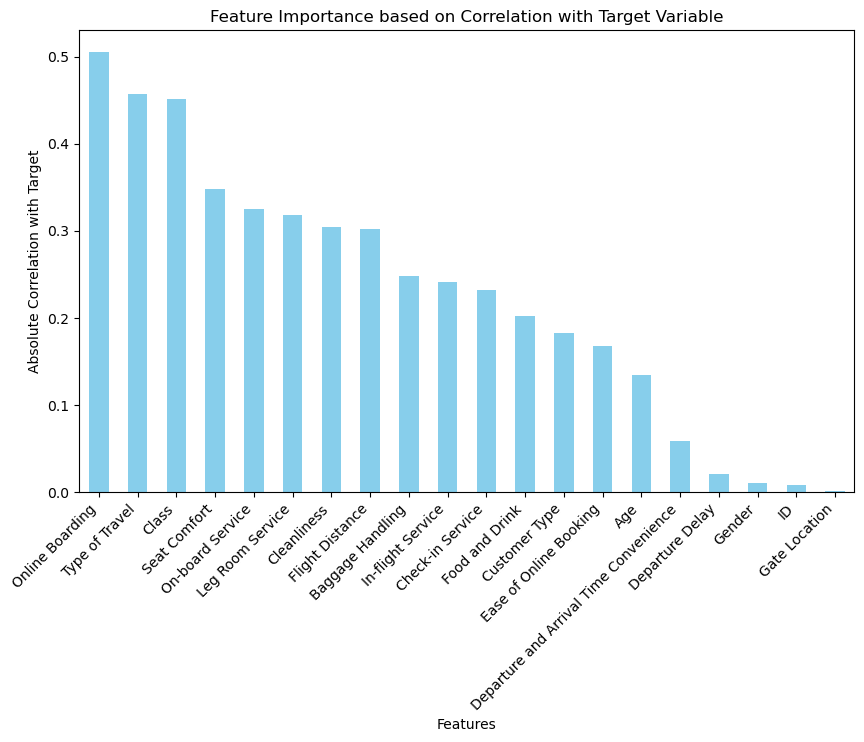

In [518]:
# Plot feature importance
plot_feature_importance(df_selected, 'Satisfaction')

In [519]:
# Remove ID, Gate Location, and Gender features
low_importance_features = ['ID', 'Gate Location', 'Gender']
df_selected = remove_low_importance_features(df_selected, low_importance_features)

# Print the updated list of features
print("Updated Features:")
print(df_selected.columns)

Updated Features:
Index(['Age', 'Customer Type', 'Type of Travel', 'Class', 'Flight Distance',
       'Departure Delay', 'Departure and Arrival Time Convenience',
       'Ease of Online Booking', 'Check-in Service', 'Online Boarding',
       'On-board Service', 'Seat Comfort', 'Leg Room Service', 'Cleanliness',
       'Food and Drink', 'In-flight Service', 'Baggage Handling',
       'Satisfaction'],
      dtype='object')


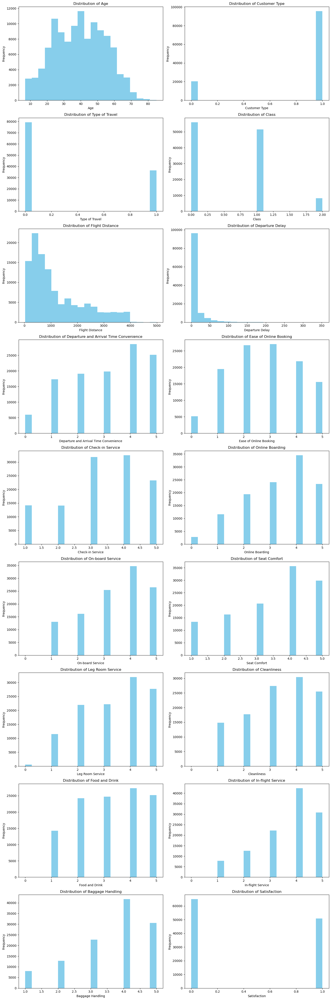

In [520]:
# Visualize numerical columns
visualize_cleaned_data(df_selected)